## MongoDB on Google Colab

Google Colab environment is based on Ubuntu Linux. The Colab runtime used Ubuntu as its underlying Operating System.
*   Check exact version of the OS in Colab environment via shell command
*   In Colab, use `!` character at the beginning of the line in code cell to run shell commands



In [ ]:
# Check version of OS in Colab environment
!lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 22.04.4 LTS
Release:	22.04
Codename:	jammy


## MongoDB Installation
MongoDB 8.0 Community Edition supports various 64-bit Ubuntu LTS releases on x86_64 architecture; 20.04 LTS ("Focal"), 22.04 LTS ("Jammy"), and 24.04 LTS ("Noble").
*   `cat /etc/lsb-release` command determines Ubuntu release of the environment.



**Please refer to** https://www.mongodb.com/docs/manual/tutorial/install-mongodb-on-ubuntu/#std-label-install-mdb-community-ubuntu

In [ ]:
# Determines Ubuntu release of the environment
! cat /etc/lsb-release

DISTRIB_ID=Ubuntu
DISTRIB_RELEASE=22.04
DISTRIB_CODENAME=jammy
DISTRIB_DESCRIPTION="Ubuntu 22.04.4 LTS"


### Import MongoDB public GPG key
To install MongoDB Community Edition, import MongoDB public GPG key.

Download `.asc` (ASCII-armored file) which contains public key.
*   `curl` (Client URL) command transfer/download data from server, with option `-f` (Fail silently on HTTP errors), `-s` (Silent mode), `-S` (Show errors) and `-L` (Follow redirects).

Pipe the output to the following command to be convert into machine-readable binary format.
*   `gpg` command uses GNU Privacy Guard (GPG) tool to perform GPG related operation such as encrypting, decrypting, signing, and verifying data; `--dearmor` option converts `.asc` file into its binary form; `-o` flag specifies output file to write the result.



In [ ]:
# Download public key in .asc file from remote server and de-armor into .gpg file
! curl -fsSL https://www.mongodb.org/static/pgp/server-8.0.asc | \
   sudo gpg -o /usr/share/keyrings/mongodb-server-8.0.gpg \
   --dearmor

gpg: cannot open '/dev/tty': No such device or address
curl: (23) Failed writing body


In [ ]:
# Check the .gpg output file
! ls -l /usr/share/keyrings/mongodb-server-8.0.gpg

-rw-r--r-- 1 root root 1178 Feb 26 15:25 /usr/share/keyrings/mongodb-server-8.0.gpg


### Install MongoDB using Package from MongoDB Repository
In Debian-based Linux distributions (like Ubuntu), additional software repositories (or package sources) are defined in repository list files stored in `/etc/apt/sources.list.d/`.

Each repository listing file contains lines with the following format

`deb [options] <repository_url> <distribution> <components>`

such as

`deb http://ppa.launchpad.net/some/ppa/ubuntu jammy main`

In [ ]:
# Observe existing repository list files
!ls -l /etc/apt/sources.list.d/

total 28
-rw-r--r-- 1 root root 132 Feb 21 14:13 archive_uri-https_cloud_r-project_org_bin_linux_ubuntu-jammy.list
-rw-r--r-- 1 root root 134 Feb 21 14:13 archive_uri-https_r2u_stat_illinois_edu_ubuntu-jammy.list
-rw-r--r-- 1 root root 139 Feb 21 14:13 cuda-ubuntu2204-x86_64.list
-rw-r--r-- 1 root root 148 Feb 21 14:13 deadsnakes-ubuntu-ppa-jammy.list
-rw-r--r-- 1 root root 160 Feb 21 14:13 graphics-drivers-ubuntu-ppa-jammy.list
-rw-r--r-- 1 root root 147 Feb 26 15:25 mongodb-org-8.0.list
-rw-r--r-- 1 root root 146 Feb 21 14:13 ubuntugis-ubuntu-ppa-jammy.list


Create the list file defining MongoDB software repository for Ubuntu 22.04 (Jammy). Save output to `/etc/apt/sources.list.d/mongodb-org-8.0.list`
*   `echo` command to print specified text or value of variables
*   `tee` command used with pipe to save intermediate output



In [ ]:
! echo "deb [ arch=amd64,arm64 signed-by=/usr/share/keyrings/mongodb-server-8.0.gpg ] https://repo.mongodb.org/apt/ubuntu jammy/mongodb-org/8.0 multiverse" | sudo tee /etc/apt/sources.list.d/mongodb-org-8.0.list

deb [ arch=amd64,arm64 signed-by=/usr/share/keyrings/mongodb-server-8.0.gpg ] https://repo.mongodb.org/apt/ubuntu jammy/mongodb-org/8.0 multiverse


In [ ]:
# Check content of the generated list file.
! cat /etc/apt/sources.list.d/mongodb-org-8.0.list

deb [ arch=amd64,arm64 signed-by=/usr/share/keyrings/mongodb-server-8.0.gpg ] https://repo.mongodb.org/apt/ubuntu jammy/mongodb-org/8.0 multiverse


Reload the local package database

In [ ]:
! sudo apt-get update

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:5 https://repo.mongodb.org/apt/ubuntu jammy/mongodb-org/8.0 InRelease
Hit:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspe

Install the latest stable version of MongoDB Community Server.

In [ ]:
! sudo apt-get install -y mongodb-org


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
mongodb-org is already the newest version (8.0.5).
0 upgraded, 0 newly installed, 0 to remove and 28 not upgraded.


## Use MongoDB
### Run MongoDB Community Edition
To run MongoDB in Colab environment, create a working directory and change both the owner and the group of the file to `mongodb`.
*   `mkdir` command creates a new directory with `-p` option to create corresponding parent directory if required.
*   `chown` command changes ownership of file or directory. Change owner and  group by specifying in the format USER:GROUP. Use `-R` option to change the ownership/group of a directory and all its contents recursively.



In [ ]:
# Create /data/db directory, create parent directories if required
!mkdir -p /data/db
# Recursively change owner and group to mongodb
!sudo chown -R mongodb:mongodb /data/db

In [ ]:
# Check /data/db directory and ownership
! ls -l /data/

total 4
drwxr-xr-x 4 mongodb mongodb 4096 Feb 26 15:53 db


**MongoDB Process**

**mongod** is primary daemon process for MongoDB system. It handles data requests, manages data access, and performs background management operations. See https://www.mongodb.com/docs/manual/reference/program/mongod/#mongodb-binary-bin.mongod

**`mongod`** command starts MongoDB process.

*   `--dbpath` option speficies directory where the mongod instance stores its data. Default is `/data/db` on Linux and macOS, `\data\db` on Windows.
*   `--bind_ip` option speficies hostnames and/or IP addresses and/or full Unix domain socket paths on which mongod should listen for client connections. Default is `localhost`.
*   `--logpath` option speficies log file to send all diagnostic logging information to instead of to standard output or to the host's syslog system.
*   `--fork` option enables a daemon mode that runs the mongod process in the background.



In [ ]:
!mongod --dbpath /data/db --bind_ip 127.0.0.1 --logpath /data/db/mongod.log --fork


about to fork child process, waiting until server is ready for connections.
forked process: 8888
ERROR: child process failed, exited with 1
To see additional information in this output, start without the "--fork" option.


After the process has been started, log can be observed. The default port that MongoDB listens to client connection is 27017.

**`tail`** command in Linux displays last few lines of a file or output from a command. By default, tail shows the last 10 lines.
*   `-n` option specifies the number of lines to display



In [ ]:
# Tail mongod.log
!tail -n 20 /data/db/mongod.log

{"t":{"$date":"2025-02-26T15:53:23.420+00:00"},"s":"I",  "c":"CONTROL",  "id":23403,   "ctx":"initandlisten","msg":"Build Info","attr":{"buildInfo":{"version":"8.0.5","gitVersion":"cb9e2e5e552ee39dea1e39d7859336456d0c9820","openSSLVersion":"OpenSSL 3.0.2 15 Mar 2022","modules":[],"allocator":"tcmalloc-google","environment":{"distmod":"ubuntu2204","distarch":"x86_64","target_arch":"x86_64"}}}}
{"t":{"$date":"2025-02-26T15:53:23.420+00:00"},"s":"I",  "c":"CONTROL",  "id":51765,   "ctx":"initandlisten","msg":"Operating System","attr":{"os":{"name":"Ubuntu","version":"22.04"}}}
{"t":{"$date":"2025-02-26T15:53:23.420+00:00"},"s":"I",  "c":"CONTROL",  "id":21951,   "ctx":"initandlisten","msg":"Options set by command line","attr":{"options":{"net":{"bindIp":"127.0.0.1"},"processManagement":{"fork":true},"storage":{"dbPath":"/data/db"},"systemLog":{"destination":"file","path":"/data/db/mongod.log"}}}}
{"t":{"$date":"2025-02-26T15:53:23.420+00:00"},"s":"E",  "c":"CONTROL",  "id":20568,   "ctx":

### Pymongo
**pymongo Installation**

PyMongo contains tools for interacting with MongoDB database from Python. The pymongo package is a native Python driver for MongoDB. See https://www.mongodb.com/docs/languages/python/pymongo-driver/current/

*   Use `pip` (default package manager for Python) to install pymongo



In [ ]:
# Use pip to install pymongo
!pip install pymongo

#### MongoClient
Connecting to a MongoDB deployment requires 2 components:


1.   **`MongoClient`** object creates the connection to the MongoDB deployment and allows operations on it.
2.   **`Connection URI`** or connection string describes which MongoDB deployment to connect to.

Connection URI includes:
*   `mongodb://` as prefix
*   `host[:port]` specifying host and optional port number where MongoDB is running
*   optional `username:password` as authentication credential
*   `/defaultauthdb` specifying authentication database to use if the connection string includes `username:password@` authentication credentials but not the `authSource` option. Without this component, client authenticates user against admin database.



#### Database Instance
To get a Database instance from a `MongoClient` use either dictionary-style or attribute-style access:
*   `clientObj['dbName']`
*   `clientObj.dbName`

For attribute names with leading underscores. Must use dict-style.

#### Collection
To access collection in database instance, use either dictionary-style or attribute-style access:
*   `dbInstance['collectionName']`
*   `dbInstance.collectionName`

For attribute names with leading underscores. Must use dict-style.

#### Insert Document
**`insert_one(document, bypass_validation=False, session=None, comment=None)`** inserts a single document.
*   `document` : Document to insert. Must be mutable mapping type. If the document does not have an `_id` field one will be added automatically.
*   `bypass_validation` : (optional) If `True`, allows write to opt-out of document level validation. Default is `False`.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns `InsertOneResult` which contains the following properties:
*   `inserted_id` : inserted document’s _id.
*   `acknowledged` : whether this result of acknowledged write operation; `False` when using `WriteConcern(w=0)`, otherwise `True`.

---

**`insert_many(documents, ordered=True, bypass_document_validation=False, session=None, comment=None)`** inserts an iterable of documents.
*   `documents` :  Iterable of documents to insert.
*   `ordered` :  If `True` (default) documents will be inserted on server serially, in order provided. If error occurs all remaining inserts are aborted. If `False`, documents will be inserted on server in arbitrary order, possibly in parallel, and all document inserts will be attempted.
*   `bypass_validation` : (optional) If `True`, allows write to opt-out of document level validation. Default is `False`.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns `InsertManyResult` which contains the following properties:
*   `inserted_ids` : list of `_ids` of the inserted documents, in the order provided.
*   `acknowledged` : whether this result of acknowledged write operation; `False` when using `WriteConcern(w=0)`, otherwise `True`.

#### Query Document
**`count_documents(filter, session=None, comment=None, **kwargs)`** count the number of documents in this collection.
*   `filter` : A query document `(Mapping[str, Any])` that selects which documents to count in the collection. Can be an empty document to count all documents.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns number of documents in `int`.

---

**`find(filter=None, projection=None, skip=0, limit=0, no_cursor_timeout=False, cursor_type=CursorType.NON_TAILABLE, sort=None, allow_partial_results=False, oplog_replay=False, batch_size=0, collation=None, hint=None, max_scan=None, max_time_ms=None, max=None, min=None, return_key=False, show_record_id=False, snapshot=False, comment=None, session=None, allow_disk_use=None)`** Query the database.
*   `filter` : A query document that selects which documents to include in the result set. Can be an empty document to include all documents.
*   `projection` : a list of field names that should be returned in the result set or a dict specifying the fields to include or exclude. If `projection` is a list, `_id` will always be returned. Use a dict to exclude fields from the result (e.g. `projection={'_id': False}`).
*   `session` : (optional) a `ClientSession` object.
*   `sort` : a list of `(key, direction)` pairs specifying the sort order for this query.

Returns `Cursor` object.

---

**`find_one(filter=None, *args, **kwargs)`** get a single document from the database. All arguments to `find()` are also valid arguments for `find_one()`, although any limit argument will be ignored.
*   `filter` : dictionary specifying the query to be performed OR any other type to be used as the value for a query for `"_id"`; for example `{"_id": 1}`.

Returns document.

In [ ]:
from pymongo import MongoClient

# Connect to MongoDB
client = MongoClient("mongodb://localhost:27017/")

# Create a database and collection
db = client['test_database']


### Test using pymongo

**`list_database_names(session=None, comment=None)`** gets a list of the names of all databases on the connected server.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns list of database names

In [ ]:
# get a list of the names of all databases on the connected server
client.list_database_names()

['accident_data', 'admin', 'config', 'local', 'test_database']

## BSON format

BSON (Bin­ary JSON) is a binary encoded serialization of JSON-like documents. Like JSON, BSON supports the embedding of documents and arrays within other documents and arrays. BSON also contains extensions that allow representation of data types that are not part of the JSON spec. For example, BSON has a Date type and a Bin Data type.

The `bson` package is an implementation of the BSON format for Python.

In [ ]:
from pymongo import MongoClient
from bson import encode, decode

# Connect to MongoDB
  # Create/use a test database
  # Create/use a test collection
collection = db['test_collection']


# Insert a sample document
doc = {
    "_id": 1,
    "name": "John Doe",
    "age": 29,
    "address": {
        "city": "New York",
        "zipcode": "10001"
    },
    "interests": ["sports", "music"]
}

collection.insert_one(doc)

# Retrieve and display the document
retrieved_doc = collection.find_one({"_id": 1})
print("Retrieved document:", retrieved_doc)

# Convert document to BSON
bson_data = encode(retrieved_doc)
print("BSON binary data (partial):", bson_data[:20], "...")  # Show just a portion since binary data is hard to read

# Decode BSON back to JSON-like format
decoded_doc = decode(bson_data)
print("Decoded document:", decoded_doc)

Retrieved document: {'_id': 1, 'name': 'John Doe', 'age': 29, 'address': {'city': 'New York', 'zipcode': '10001'}, 'interests': ['sports', 'music']}
BSON binary data (partial): b'\x89\x00\x00\x00\x10_id\x00\x01\x00\x00\x00\x02name\x00\t' ...
Decoded document: {'_id': 1, 'name': 'John Doe', 'age': 29, 'address': {'city': 'New York', 'zipcode': '10001'}, 'interests': ['sports', 'music']}


## CRUD Operations

CRUD stands for Create, Read, Update, and Delete, and it represents 4 basic operations that can be performed on data in database

#### insert_one, insert_many

In [ ]:
  # Create/use a test database
  # Create/use a test collection

# insert {"name": "Alice", "age": 25}
collection.insert_one({"name": "Alice", "age": 25})
# insert [{"name": "Bob", "age": 30}, {"name": "Charlie", "age": 35}]
collection.insert_many([{"name": "Bob", "age": 30}, {"name": "Charlie", "age": 35}])

InsertManyResult([ObjectId('67bf38f53123362a8c2717ec'), ObjectId('67bf38f53123362a8c2717ed')], acknowledged=True)

#### find_one, find

In [ ]:
# Use find_one
collection.find_one() # Return first doc

{'_id': ObjectId('67bf38e23123362a8c2717e7'), 'name': 'Alice', 'age': 25}

In [ ]:
list(collection.find({"name":"Alice"}, {"age": 1, "_id":0}))

[{'age': 25}, {'age': 25}]

In [ ]:
# Use find_one to find {"name": "Bob"}
collection.find_one({"name": "Bob"})

{'_id': ObjectId('67bf38e23123362a8c2717e8'), 'name': 'Bob', 'age': 30}

In [ ]:
# Use find()
collection.find()

In [ ]:
list(collection.find())

[{'_id': ObjectId('67bf38e23123362a8c2717e7'), 'name': 'Alice', 'age': 25},
 {'_id': ObjectId('67bf38e23123362a8c2717e8'), 'name': 'Bob', 'age': 30},
 {'_id': ObjectId('67bf38e23123362a8c2717e9'), 'name': 'Charlie', 'age': 35},
 {'_id': 1,
  'name': 'John Doe',
  'age': 29,
  'address': {'city': 'New York', 'zipcode': '10001'},
  'interests': ['sports', 'music']},
 {'_id': ObjectId('67bf38f53123362a8c2717eb'), 'name': 'Alice', 'age': 25},
 {'_id': ObjectId('67bf38f53123362a8c2717ec'), 'name': 'Bob', 'age': 30},
 {'_id': ObjectId('67bf38f53123362a8c2717ed'), 'name': 'Charlie', 'age': 35}]

#### update_one, update_many

**`update_one(filter, update, upsert=False, bypass_document_validation=False, collation=None, array_filters=None, hint=None, session=None, let=None, comment=None)`** updates a single document matching the filter.
*   `filter` : A query that matches the document to update, (`Mapping[str, Any]`).
*   `update` : The modifications to apply. (`Union[Mapping[str, Any], _Pipeline]`)
*   `upsert` :  If `True`, perform an insert if no documents match the filter.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns instance of `UpdateResult`, which properties such as
*   `raw_result` : raw result document returned by the server
*   `matched_count` : number of documents matched for this update
*   `modified_count` : number of documents modified
*   `acknowledged` : whether this result of acknowledged write operation; `False` when using `WriteConcern(w=0)`, otherwise `True`.
*   `upserted_id` : `_id` of the inserted document if an upsert took place. Otherwise `None`.

---

**`update_many(filter, update, upsert=False, array_filters=None, bypass_document_validation=None, collation=None, hint=None, session=None, let=None, comment=None)`** update one or more documents that match the filter.
*   `filter` : A query that matches the document to update, (`Mapping[str, Any]`).
*   `update` : The modifications to apply. (`Union[Mapping[str, Any], _Pipeline]`)
*   `upsert` :  If `True`, perform an insert if no documents match the filter.
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns instance of `UpdateResult`

In [ ]:
# Use update_one to update {"name": "Alice"} perform {"$set": {"age": 26}}
updateResult = collection.update_one({"name" : "Alice"}, {"$set": {"age":26}})
print("Number of documents matched:", updateResult.matched_count)
print("Number of documents modified:", updateResult.modified_count)

Number of documents matched: 1
Number of documents modified: 1


In [ ]:
# Observe collection
for doc in collection.find():
    print(doc)

{'_id': ObjectId('67bf38e23123362a8c2717e7'), 'name': 'Alice', 'age': 26}
{'_id': ObjectId('67bf38e23123362a8c2717e8'), 'name': 'Bob', 'age': 30}
{'_id': ObjectId('67bf38e23123362a8c2717e9'), 'name': 'Charlie', 'age': 35}
{'_id': 1, 'name': 'John Doe', 'age': 29, 'address': {'city': 'New York', 'zipcode': '10001'}, 'interests': ['sports', 'music']}
{'_id': ObjectId('67bf38f53123362a8c2717eb'), 'name': 'Alice', 'age': 25}
{'_id': ObjectId('67bf38f53123362a8c2717ec'), 'name': 'Bob', 'age': 30}
{'_id': ObjectId('67bf38f53123362a8c2717ed'), 'name': 'Charlie', 'age': 35}


In [ ]:
# Use update_many to update documents with {"age": {"$lt": 32}} perform {"$set": {"status": "young"}}
updateResult = collection.update_many({"age":{"$lt":32}}, {"$set":{"status":"young"}})

print("Number of documents matched:", updateResult.matched_count)
print("Number of documents modified:", updateResult.modified_count)

Number of documents matched: 5
Number of documents modified: 5


In [ ]:
# Observe collection
for doc in collection.find():
    print(doc)

{'_id': ObjectId('67bf38e23123362a8c2717e7'), 'name': 'Alice', 'age': 26, 'status': 'young'}
{'_id': ObjectId('67bf38e23123362a8c2717e8'), 'name': 'Bob', 'age': 30, 'status': 'young'}
{'_id': ObjectId('67bf38e23123362a8c2717e9'), 'name': 'Charlie', 'age': 35}
{'_id': 1, 'name': 'John Doe', 'age': 29, 'address': {'city': 'New York', 'zipcode': '10001'}, 'interests': ['sports', 'music'], 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717eb'), 'name': 'Alice', 'age': 25, 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717ec'), 'name': 'Bob', 'age': 30, 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717ed'), 'name': 'Charlie', 'age': 35}


#### delete_one, delete_many

**`delete_one(filter, collation=None, hint=None, session=None, let=None, comment=None)`** deletes a single document matching the filter.

*   `filter` : A query that matches the document to delete, (`Mapping[str, Any]`).
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns instance of `DeleteResult`, which properties such as
*   `raw_result` : raw result document returned by the server
*   `deleted_count` : number of documents deleted
*   `acknowledged` : whether this result of acknowledged write operation; `False` when using `WriteConcern(w=0)`, otherwise `True`.


---

**`delete_many(filter, collation=None, hint=None, session=None, let=None, comment=None)`** delete one or more documents matching the filter.
*   `filter` : A query that matches the document to delete, (`Mapping[str, Any]`).
*   `session` : (optional) a `ClientSession` object.
*   `comment` : (optional) user-provided comment to attach to this command.

Returns instance of `DeleteResult`

To delete all documents, call `delete_many` with empty filter `{}`.

In [ ]:
# Use delete_one to delete document with {"name": "Charlie"}
collection.delete_one({"name":"Charlie"})

# Observe collection
for doc in collection.find():
    print(doc)

{'_id': ObjectId('67bf38e23123362a8c2717e7'), 'name': 'Alice', 'age': 26, 'status': 'young'}
{'_id': ObjectId('67bf38e23123362a8c2717e8'), 'name': 'Bob', 'age': 30, 'status': 'young'}
{'_id': 1, 'name': 'John Doe', 'age': 29, 'address': {'city': 'New York', 'zipcode': '10001'}, 'interests': ['sports', 'music'], 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717eb'), 'name': 'Alice', 'age': 25, 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717ec'), 'name': 'Bob', 'age': 30, 'status': 'young'}
{'_id': ObjectId('67bf38f53123362a8c2717ed'), 'name': 'Charlie', 'age': 35}


In [ ]:
# Use delete_many to delete documents with {"age": {"$lt":35}}
collection.delete_many({"age":{"$lt":35}})

# Observe collection
for doc in collection.find():
    print(doc)

{'_id': ObjectId('67bf38f53123362a8c2717ed'), 'name': 'Charlie', 'age': 35}


## Aggregation Function

In this exercise, we will read data from an excel file, convert to a dictionary representing record-like documents of data, and insert them into collection in the database.

Excel file https://data.go.th/dataset/d46af694-d117-4253-b426-1203a6213d30/resource/78d4f56e-8f2f-4bb8-90c8-93d945237dff/download/___51-58_cutname_newyear_edit.xlsx stores data:

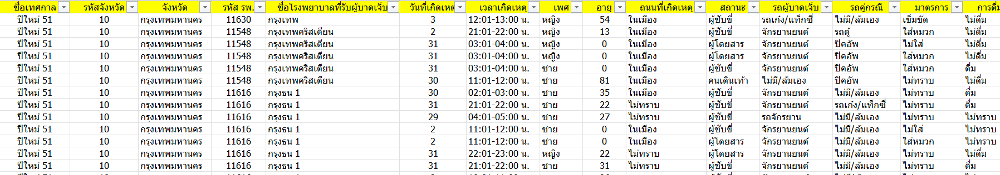

In [ ]:
import pandas as pd

df=pd.read_excel('https://data.go.th/dataset/d46af694-d117-4253-b426-1203a6213d30/resource/78d4f56e-8f2f-4bb8-90c8-93d945237dff/download/___51-58_cutname_newyear_edit.xlsx')
df

,ชื่อเทศกาล,รหัสจังหวัด,จังหวัด,รหัส รพ.,ชื่อโรงพยาบาลที่รับผู้บาดเจ็บ,วันที่เกิดเหตุ,เวลาเกิดเหตุ,เพศ,อายุ,ถนนที่เกิดเหตุ,สถานะ,รถผู้บาดเจ็บ,รถคู่กรณี,มาตรการ,การดื่มสุรา,การนำส่ง,Refer-Admit,ผลการรักษา,จำนวนวันรักษา
0,ปีใหม่ 51,10,กรุงเทพมหานคร,11630,กรุงเทพ,3,12:01-13:00 น.,หญิง,54,ในเมือง,ผู้ชับขี่,รถเก๋ง/แท็กซี่,ไม่มี/ล้มเอง,เข็มขัด,ไม่ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
1,ปีใหม่ 51,10,กรุงเทพมหานคร,11548,กรุงเทพคริสเตียน,2,21:01-22:00 น.,หญิง,13,ในเมือง,ผู้ชับขี่,จักรยานยนต์,รถตู้,ใส่หมวก,ไม่ดื่ม,มูลนิธิ/อาสาสมัคร,admit,ทุเลา/หาย,0
2,ปีใหม่ 51,10,กรุงเทพมหานคร,11548,กรุงเทพคริสเตียน,31,03:01-04:00 น.,หญิง,0,ในเมือง,ผู้โดยสาร,จักรยานยนต์,ปิคอัพ,ไม่ใส่,ไม่ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
3,ปีใหม่ 51,10,กรุงเทพมหานคร,11548,กรุงเทพคริสเตียน,31,03:01-04:00 น.,หญิง,0,ในเมือง,ผู้โดยสาร,จักรยานยนต์,ปิคอัพ,ใส่หมวก,ไม่ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
4,ปีใหม่ 51,10,กรุงเทพมหานคร,11548,กรุงเทพคริสเตียน,31,03:01-04:00 น.,ชาย,0,ในเมือง,ผู้ชับขี่,จักรยานยนต์,ปิคอัพ,ใส่หมวก,ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214945,ปีใหม่ 58,97,บึงกาฬ,11049,ศรีวิไล,31,09:01-10:00 น.,ชาย,3,ชนบท,คนเดินเท้า,ไม่มี/ล้มเอง,จักรยานยนต์,ไม่ใส่,ไม่ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
214946,ปีใหม่ 58,97,บึงกาฬ,11049,ศรีวิไล,30,16:01-17:00 น.,หญิง,4,ชนบท,คนเดินเท้า,ไม่มี/ล้มเอง,จักรยานยนต์,ไม่ใส่,ไม่ดื่ม,ผู้ประสบเหตุ/ญาติ,ไม่,ทุเลา/หาย,0
214947,ปีใหม่ 58,97,บึงกาฬ,11049,ศรีวิไล,30,24:01-01:00 น.,ชาย,20,ชนบท,ผู้ชับขี่,จักรยานยนต์,ปิคอัพ,ไม่ใส่,ไม่ดื่ม,ALS,ส่งต่อก่อน admit,ทุเลา/หาย,0
214948,ปีใหม่ 58,97,บึงกาฬ,11049,ศรีวิไล,31,14:01-15:00 น.,ชาย,16,ชนบท,ผู้ชับขี่,จักรยานยนต์,ไม่มี/ล้มเอง,ไม่ใส่,ดื่ม,FR,ส่งต่อก่อน admit,ทุเลา/หาย,0


**`DataFrame.to_dict(orient='dict', *, into=<class 'dict'>, index=True)`** convert the DataFrame to a dictionary.
*   `orient` : type of the values of the dictionary. Default is 'dict' produces dict like `{column -> {index -> value}}`. With orient 'records' the key-value pairs are list like `[{column -> value}, … , {column -> value}]`
*   `into` : class `collections.abc.MutableMapping` subclass used for all Mappings in the return value. Default is `dict`.
*   `index` : Whether to include the index item. Default is `True`.



In [ ]:
# Convert DataFrame to Dictionary
list_of_dicts = df.to_dict('records')

In [ ]:
# Check existing databases
client.list_database_names()

['accident_data', 'admin', 'config', 'local', 'test_database']

In [ ]:
# Insert into collection 'main_data' of database 'accident_data'
accident_db = client['accident_data']
main_collection = accident_db['main_data']
main_collection.insert_many(list_of_dicts)

InsertManyResult([ObjectId('67bf391d3123362a8c2717ee'), ObjectId('67bf391d3123362a8c2717ef'), ObjectId('67bf391d3123362a8c2717f0'), ObjectId('67bf391d3123362a8c2717f1'), ObjectId('67bf391d3123362a8c2717f2'), ObjectId('67bf391d3123362a8c2717f3'), ObjectId('67bf391d3123362a8c2717f4'), ObjectId('67bf391d3123362a8c2717f5'), ObjectId('67bf391d3123362a8c2717f6'), ObjectId('67bf391d3123362a8c2717f7'), ObjectId('67bf391d3123362a8c2717f8'), ObjectId('67bf391d3123362a8c2717f9'), ObjectId('67bf391d3123362a8c2717fa'), ObjectId('67bf391d3123362a8c2717fb'), ObjectId('67bf391d3123362a8c2717fc'), ObjectId('67bf391d3123362a8c2717fd'), ObjectId('67bf391d3123362a8c2717fe'), ObjectId('67bf391d3123362a8c2717ff'), ObjectId('67bf391d3123362a8c271800'), ObjectId('67bf391d3123362a8c271801'), ObjectId('67bf391d3123362a8c271802'), ObjectId('67bf391d3123362a8c271803'), ObjectId('67bf391d3123362a8c271804'), ObjectId('67bf391d3123362a8c271805'), ObjectId('67bf391d3123362a8c271806'), ObjectId('67bf391d3123362a8c2718

### Data Exploration
**`db.list_collection_names()`** list the collections in a database







In [ ]:
# Observe database changes
client['accident_data'].list_collection_names()

['main_data']

In [ ]:
# Access main_data collection and access first document
main_collection.find_one()

{'_id': ObjectId('67bf36b63123362a8c23d041'),
 'ชื่อเทศกาล': 'ปีใหม่ 51',
 'รหัสจังหวัด': 10,
 'จังหวัด': 'กรุงเทพมหานคร',
 'รหัส รพ.': 11630,
 'ชื่อโรงพยาบาลที่รับผู้บาดเจ็บ': 'กรุงเทพ',
 'วันที่เกิดเหตุ': 3,
 'เวลาเกิดเหตุ': '12:01-13:00 น.',
 'เพศ': 'หญิง',
 'อายุ': 54,
 'ถนนที่เกิดเหตุ': 'ในเมือง',
 'สถานะ': 'ผู้ชับขี่',
 'รถผู้บาดเจ็บ': 'รถเก๋ง/แท็กซี่',
 'รถคู่กรณี': 'ไม่มี/ล้มเอง',
 'มาตรการ': 'เข็มขัด',
 'การดื่มสุรา': 'ไม่ดื่ม',
 'การนำส่ง': 'ผู้ประสบเหตุ/ญาติ',
 'Refer-Admit': 'ไม่',
 'ผลการรักษา': 'ทุเลา/หาย',
 'จำนวนวันรักษา': 0}

#### Filter by Some Columns

In [ ]:
[rec for rec in main_collection.find({'อายุ':{'$gt':50},'รถผู้บาดเจ็บ':'จักรยานยนต์'}, {'รถคู่กรณี':1})]

[{'_id': ObjectId('67bf36b63123362a8c23d053'), 'รถคู่กรณี': 'จักรยานยนต์'},
 {'_id': ObjectId('67bf36b63123362a8c23d069'), 'รถคู่กรณี': 'จักรยานยนต์'},
 {'_id': ObjectId('67bf36b63123362a8c23d078'), 'รถคู่กรณี': 'รถเก๋ง/แท็กซี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d08b'), 'รถคู่กรณี': 'ไม่ทราบ'},
 {'_id': ObjectId('67bf36b63123362a8c23d08e'), 'รถคู่กรณี': 'รถเก๋ง/แท็กซี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d09b'), 'รถคู่กรณี': 'รถเก๋ง/แท็กซี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d09f'), 'รถคู่กรณี': 'จักรยานยนต์'},
 {'_id': ObjectId('67bf36b63123362a8c23d0a4'), 'รถคู่กรณี': 'จักรยานยนต์'},
 {'_id': ObjectId('67bf36b63123362a8c23d0c9'), 'รถคู่กรณี': 'รถเก๋ง/แท็กซี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d13d'), 'รถคู่กรณี': 'รถตู้'},
 {'_id': ObjectId('67bf36b63123362a8c23d154'), 'รถคู่กรณี': 'ไม่มี/ล้มเอง'},
 {'_id': ObjectId('67bf36b63123362a8c23d171'), 'รถคู่กรณี': 'ไม่มี/ล้มเอง'},
 {'_id': ObjectId('67bf36b63123362a8c23d17f'), 'รถคู่กรณี': 'ปิคอัพ'},
 {'_id': Obje

## Regex

### **Basic Syntax**
```python
collection.find({"field": {"$regex": "pattern"}})
```

---

### **Examples of Regular Expressions in PyMongo**

#### 1. **Match a Substring**
Find documents where the field contains the substring "abc":
```
results = collection.find({"field": {"$regex": "abc"}})
```

#### 2. **Match Beginning of a String**
Use `^` to match strings starting with "abc":
```python
results = collection.find({"field": {"$regex": "^abc"}})
```

#### 3. **Match End of a String**
Use `$` to match strings ending with "xyz":
```python
results = collection.find({"field": {"$regex": "xyz$"}})
```

#### 4. **Match Any Character (Wildcard)**
Use `.` to match any single character:
```python
results = collection.find({"field": {"$regex": "a.c"}})  # Matches "abc", "a_c", etc.
```

#### 5. **Match Zero or More Occurrences**
Use `*` to match zero or more of the preceding character:
```python
results = collection.find({"field": {"$regex": "a*"}})  # Matches "a", "aa", "", etc.
```

#### 6. **Match One or More Occurrences**
Use `+` to match one or more of the preceding character:
```python
results = collection.find({"field": {"$regex": "a+"}})  # Matches "a", "aa", etc. (but not empty strings)
```

#### 7. **Match a Range of Characters**
Use `[ ]` to define a range:
```python
results = collection.find({"field": {"$regex": "[a-c]"}})  # Matches "a", "b", or "c"
```

#### 8. **Exclude Characters**
Use `[^ ]` to exclude a range of characters:
```python
results = collection.find({"field": {"$regex": "[^a-c]"}})  # Matches anything except "a", "b", or "c"
```



**`collection.distinct(key, filter=None)`** finds the distinct field values across a subset of documents in a collection

*   `key` : name of fieldto find distinct values for
*   `filter` : query filter that specifies the documents to retrieve distinct values from



In [ ]:
# Get distinct value for field 'ผลการรักษา' of accident_collection
main_collection.distinct('ผลการรักษา')

['ตายที่ห้องฉุกเฉิน',
 'ตายที่เกิดเหตุ',
 'ตายระหว่างนำส่ง',
 'ตายระหว่างส่งต่อ',
 'ตายในตึกภายใน 24 ชม. หลังเหตุ',
 'ตายในตึกหลัง 24 ชม. - 30 วัน',
 'ทุเลา/หาย']

In [ ]:
# substring with regex for ผลการรักษา that matches substring ตาย
# This give that same result as accident_collection.distinct('ผลการรักษา', filter={"ผลการรักษา": {"$regex": "ตาย"}})
main_collection.find({'ผลการรักษา':{'$regex':'ตาย'}}).distinct('ผลการรักษา')

['ตายที่ห้องฉุกเฉิน',
 'ตายที่เกิดเหตุ',
 'ตายระหว่างนำส่ง',
 'ตายระหว่างส่งต่อ',
 'ตายในตึกภายใน 24 ชม. หลังเหตุ',
 'ตายในตึกหลัง 24 ชม. - 30 วัน']

In [ ]:
main_collection.distinct('ผลการรักษา', filter={"ผลการรักษา": {"$regex": "ตาย"}})

['ตายที่ห้องฉุกเฉิน',
 'ตายที่เกิดเหตุ',
 'ตายระหว่างนำส่ง',
 'ตายระหว่างส่งต่อ',
 'ตายในตึกภายใน 24 ชม. หลังเหตุ',
 'ตายในตึกหลัง 24 ชม. - 30 วัน']

In [ ]:
[rec for rec in main_collection.find({'สถานะ':{'$regex': 'ขี่'}}, {'สถานะ':1})]

[{'_id': ObjectId('67bf36b63123362a8c23d041'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d042'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d045'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d047'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d048'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d049'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d04a'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d04d'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d04e'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d04f'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d050'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d051'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d054'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('67bf36b63123362a8c23d055'), 'สถานะ': 'ผู้ชับขี่'},
 {'_id': ObjectId('6

In [ ]:
# finds the distinct field values for 'เวลาเกิดเหตุ'
main_collection.distinct('เวลาเกิดเหตุ')

['01:01-02:00 น.',
 '02:01-03:00 น.',
 '03:01-04:00 น.',
 '04:01-05:00 น.',
 '05:01-06:00 น.',
 '06:01-07:00 น.',
 '07:01-08:00 น.',
 '08:01-09:00 น.',
 '09:01-10:00 น.',
 '10:01-11:00 น.',
 '11:01-12:00 น.',
 '12:01-13:00 น.',
 '13:01-14:00 น.',
 '14:01-15:00 น.',
 '15:01-16:00 น.',
 '16:01-17:00 น.',
 '17:01-18:00 น.',
 '18:01-19:00 น.',
 '19:01-20:00 น.',
 '20:01-21:00 น.',
 '21:01-22:00 น.',
 '22:01-23:00 น.',
 '23:01-24:00 น.',
 '24:01-01:00 น.',
 'ไม่ทราบ']

In [ ]:
# Observe เวลาเกิดเหตุ that starts with 12
main_collection.find({"เวลาเกิดเหตุ": {"$regex": "^12"}}).distinct('เวลาเกิดเหตุ')

['12:01-13:00 น.']

In [ ]:
# Find number of documents which เวลาเกิดเหตุ that starts with 12
main_collection.count_documents({"เวลาเกิดเหตุ": {"$regex": "^12"}})

20052

In [ ]:
# choose documents only from 21, 22, 23, 24 hr
list(main_collection.find({"เวลาเกิดเหตุ":{"$regex":"^(21|22|23|24)"}}, {'เวลาเกิดเหตุ':1, '_id':0}))

[{'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '22:01-23:00 น.'},
 {'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '22:01-23:00 น.'},
 {'เวลาเกิดเหตุ': '22:01-23:00 น.'},
 {'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '22:01-23:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '23:01-24:00 น.'},
 {'เวลาเกิดเหตุ': '22:01-23:00 น.'},
 {'เวลาเกิดเหตุ': '21:01-22:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 {'เวลาเกิดเหตุ': '24:01-01:00 น.'},
 

### Actual Aggragation Function

**`collection.aggregate(pipeline)`** performs an aggregation using the aggregation framework on this collection. It processes and transforms data through a series of stages, such as filtering, grouping, sorting, and more, using MongoDB's aggregation pipeline.
*   `pipeline` : list of aggregation pipeline stages. Each stage is a dictionary specifying an operation

Example of aggregation stages
1.   `$match`: Filters documents
2.   `$group`: Groups documents by a specified field and performs aggregations like sum, average, etc.
3.   `$sort`: Sorts documents.
4.   `$limit`: Limits the number of documents.

In [ ]:
# Filter for documents that "ผลการรักษา" contains "ตาย"
# Sum number of documents as count Group by จังหวัด
# Sort count in descending order
# Limit to 10

results = main_collection.aggregate([
    {
        "$match" : {
            "ผลการรักษา" : {"$regex" : "ตาย"}
        }
    },
    {
        "$group" : {
            "_id" : "$จังหวัด",
            "count" : {"$sum":1}
        }
    },
    {"$sort":{"count":-1}},
    {"$limit":10}

])

[rec for rec in results]

[{'_id': 'นครราชสีมา', 'count': 246},
 {'_id': 'เชียงใหม่', 'count': 240},
 {'_id': 'ขอนแก่น', 'count': 206},
 {'_id': 'นครสวรรค์', 'count': 206},
 {'_id': 'บุรีรัมย์', 'count': 202},
 {'_id': 'นครปฐม', 'count': 188},
 {'_id': 'เชียงราย', 'count': 178},
 {'_id': 'สุราษฎร์ธานี', 'count': 174},
 {'_id': 'เพชรบูรณ์', 'count': 166},
 {'_id': 'ระยอง', 'count': 160}]

In [ ]:
# Slice the df data frame for rows that "ผลการรักษา" contains "ตาย"
# Group by จังหวัด with count
# Sort by ชื่อเทศกาล in descending order
# Slice for column 'ชื่อเทศกาล' for 10 rows
df[df['ผลการรักษา'].str.contains('ตาย')].groupby('จังหวัด').count().sort_values(by='ชื่อเทศกาล',ascending=False)['ชื่อเทศกาล'].iloc[0:10]

,ชื่อเทศกาล
จังหวัด,
นครราชสีมา,123
เชียงใหม่,120
ขอนแก่น,103
นครสวรรค์,103
บุรีรัมย์,101
นครปฐม,94
เชียงราย,89
สุราษฎร์ธานี,87
เพชรบูรณ์,83


## Full text search

**KaggleHub** is a Python package that provides a simple API to access Kaggle resources

**`kagglehub.dataset_download(dataset)`** downloads the latest version of Kaggle dataset.

In [ ]:
import kagglehub

# Download latest version. See https://www.kaggle.com/datasets/zynicide/wine-reviews
path = kagglehub.dataset_download("zynicide/wine-reviews")

print("Path to dataset files:", path)

100%|██████████| 50.9M/50.9M [00:00<00:00, 82.4MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/zynicide/wine-reviews/versions/4


In [ ]:
# List the file stored in our colab VM environment
! ls -l /root/.cache/kagglehub/datasets/zynicide/wine-reviews/versions/4/

total 177724
-rw-r--r-- 1 root root 52908706 Feb 26 17:00 winemag-data-130k-v2.csv
-rw-r--r-- 1 root root 79279294 Feb 26 17:00 winemag-data-130k-v2.json
-rw-r--r-- 1 root root 49784334 Feb 26 17:00 winemag-data_first150k.csv


In [ ]:
# Read file winemag-data-130k-v2.csv into DataFrame
wine_df=pd.read_csv('/root/.cache/kagglehub/datasets/zynicide/wine-reviews/versions/4/winemag-data-130k-v2.csv')

In [ ]:
# Show the DataFrame
wine_df

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129966,129966,Germany,Notes of honeysuckle and cantaloupe sweeten th...,Brauneberger Juffer-Sonnenuhr Spätlese,90,28.0,Mosel,NaN,NaN,Anna Lee C. Iijima,NaN,Dr. H. Thanisch (Erben Müller-Burggraef) 2013 ...,Riesling,Dr. H. Thanisch (Erben Müller-Burggraef)
129967,129967,US,Citation is given as much as a decade of bottl...,NaN,90,75.0,Oregon,Oregon,Oregon Other,Paul Gregutt,@paulgwine,Citation 2004 Pinot Noir (Oregon),Pinot Noir,Citation
129968,129968,France,Well-drained gravel soil gives this wine its c...,Kritt,90,30.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Domaine Gresser 2013 Kritt Gewurztraminer (Als...,Gewürztraminer,Domaine Gresser
129969,129969,France,"A dry style of Pinot Gris, this is crisp with ...",NaN,90,32.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Domaine Marcel Deiss 2012 Pinot Gris (Alsace),Pinot Gris,Domaine Marcel Deiss


In [ ]:
# Convert wine_df to dictionary
# With orient 'records' the key-value pairs are list like [{column -> value}, … , {column -> value}]
# Insert into collection 'winemag-data-130k-v2' of database 'wine_data'

wine_list_of_dicts = wine_df.to_dict('records')
wine_db = client['wine_data']
wine_collection = wine_db['winemag-data-130k-v2']
wine_collection.insert_many(wine_list_of_dicts)

InsertManyResult([ObjectId('67bf493b3123362a8c2a5f94'), ObjectId('67bf493b3123362a8c2a5f95'), ObjectId('67bf493b3123362a8c2a5f96'), ObjectId('67bf493b3123362a8c2a5f97'), ObjectId('67bf493b3123362a8c2a5f98'), ObjectId('67bf493b3123362a8c2a5f99'), ObjectId('67bf493b3123362a8c2a5f9a'), ObjectId('67bf493b3123362a8c2a5f9b'), ObjectId('67bf493b3123362a8c2a5f9c'), ObjectId('67bf493b3123362a8c2a5f9d'), ObjectId('67bf493b3123362a8c2a5f9e'), ObjectId('67bf493b3123362a8c2a5f9f'), ObjectId('67bf493b3123362a8c2a5fa0'), ObjectId('67bf493b3123362a8c2a5fa1'), ObjectId('67bf493b3123362a8c2a5fa2'), ObjectId('67bf493b3123362a8c2a5fa3'), ObjectId('67bf493b3123362a8c2a5fa4'), ObjectId('67bf493b3123362a8c2a5fa5'), ObjectId('67bf493b3123362a8c2a5fa6'), ObjectId('67bf493b3123362a8c2a5fa7'), ObjectId('67bf493b3123362a8c2a5fa8'), ObjectId('67bf493b3123362a8c2a5fa9'), ObjectId('67bf493b3123362a8c2a5faa'), ObjectId('67bf493b3123362a8c2a5fab'), ObjectId('67bf493b3123362a8c2a5fac'), ObjectId('67bf493b3123362a8c2a5f

In [ ]:
# load collection 'winemag-data-130k-v2' of database 'wine_data'


In [ ]:
# Observe a document
wine_collection.find_one()

{'_id': ObjectId('67bf493b3123362a8c2a5f94'),
 'Unnamed: 0': 0,
 'country': 'Italy',
 'description': "Aromas include tropical fruit, broom, brimstone and dried herb. The palate isn't overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity.",
 'designation': 'Vulkà Bianco',
 'points': 87,
 'price': nan,
 'province': 'Sicily & Sardinia',
 'region_1': 'Etna',
 'region_2': nan,
 'taster_name': 'Kerin O’Keefe',
 'taster_twitter_handle': '@kerinokeefe',
 'title': 'Nicosia 2013 Vulkà Bianco  (Etna)',
 'variety': 'White Blend',
 'winery': 'Nicosia'}

**`collection.create_index(keys)`** creates an index on collection.
*   `keys` : a key or a list containing (key, direction) pairs or keys. If no direction is given, ASCENDING will be assumed.



In [ ]:
# Create index for wine_collection on key 'description' with 'text' direction (text index)
wine_collection.create_index([('description', 'text')])

'description_text'

In [ ]:
# With text index, perform text search
# Use $text operator to search for text in fields that have text index
# Use $search operator to give the term to search for
import time

query = {'$text': {'$search': 'fruity'}}

start_time = time.time()

results = wine_collection.find(query)
show_docs = [rec for rec in results]
print(f"Total Execution Time: {time.time()-start_time:.6f} seconds")


Total Execution Time: 0.126108 seconds


In [ ]:
print(show_docs)

[{'_id': ObjectId('67bf493c3123362a8c2bd4f0'), 'Unnamed: 0': 95580, 'country': 'France', 'description': 'This attractively fruity offering features floral, fruity flavors that are cut by crisp acidity. It is a bright, light and fruity sparkler, with just a touch of sweetness.', 'designation': 'Blanc de Blancs', 'points': 84, 'price': 13.0, 'province': 'France Other', 'region_1': 'Vin Mousseux', 'region_2': nan, 'taster_name': 'Roger Voss', 'taster_twitter_handle': '@vossroger', 'title': 'Marquis de Perlade NV Blanc de Blancs Sparkling (Vin Mousseux)', 'variety': 'Sparkling Blend', 'winery': 'Marquis de Perlade'}, {'_id': ObjectId('67bf493c3123362a8c2bddc8'), 'Unnamed: 0': 97844, 'country': 'Austria', 'description': 'Almost luscious pear aromas and notes of peardrop make for a very fruity nose. The palate has a fruity, lemony ease, while the body is slender, dry and has some spritz. The lemon freshness is vivid, brightening everything on this easy, fruity summer wine.', 'designation': '

In [ ]:
# When text index is not used
# Perform regex search on "description"
# Query for all documents where "description" contains substring "fruity"
query = {'description':{'$regex':'fruity'}}

start_time = time.time()

results = wine_collection.find(query)
show_docs = [rec for rec in results]
print(f"Total Execution Time: {time.time()-start_time:.6f} seconds")

print(show_docs)

Total Execution Time: 0.182144 seconds
[{'_id': ObjectId('67bf493b3123362a8c2a5f95'), 'Unnamed: 0': 1, 'country': 'Portugal', 'description': "This is ripe and fruity, a wine that is smooth while still structured. Firm tannins are filled out with juicy red berry fruits and freshened with acidity. It's  already drinkable, although it will certainly be better from 2016.", 'designation': 'Avidagos', 'points': 87, 'price': 15.0, 'province': 'Douro', 'region_1': nan, 'region_2': nan, 'taster_name': 'Roger Voss', 'taster_twitter_handle': '@vossroger', 'title': 'Quinta dos Avidagos 2011 Avidagos Red (Douro)', 'variety': 'Portuguese Red', 'winery': 'Quinta dos Avidagos'}, {'_id': ObjectId('67bf493b3123362a8c2a5f9c'), 'Unnamed: 0': 8, 'country': 'Germany', 'description': "Savory dried thyme notes accent sunnier flavors of preserved peach in this brisk, off-dry wine. It's fruity and fresh, with an elegant, sprightly footprint.", 'designation': 'Shine', 'points': 87, 'price': 12.0, 'province': 'Rh